In [191]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageOps, ImageFilter, ImageEnhance
from plantcv import plantcv as pcv
from plantcv.parallel import WorkflowInputs
import cv2
import tensorflow as tf

In [111]:
IMAGE_SIZE = 256
BATCH_SIZE = 32
CHANNELS = 3
EPOCHS = 10

In [169]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
	"../leaves/images/", 
	shuffle = True, 
	image_size = (IMAGE_SIZE, IMAGE_SIZE), 
	batch_size = BATCH_SIZE
)
class_names = dataset.class_names

Found 7221 files belonging to 8 classes.


(-0.5, 767.5, 351.5, -0.5)

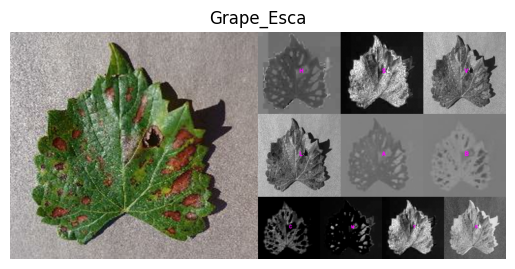

In [214]:
for image_batch, label_batch in dataset.take(1):
	img = image_batch[0].numpy().astype("uint8")
	type_leave = class_names[label_batch[0]]
colospace = pcv.visualize.colorspaces(rgb_img=img)
plt.imshow(colospace)
plt.title(type_leave)
plt.axis("off")

In [225]:
def remove_back(img, threshold, size_fill, enhance_val):
	img_img = Image.fromarray(img, mode="RGB")
	contr_img = ImageEnhance.Contrast(img_img).enhance(enhance_val)
	img2 = np.array(contr_img)
	gray_img = pcv.rgb2gray_cmyk(rgb_img=img2, channel='y')
	thresh = pcv.threshold.binary(gray_img=gray_img, threshold=threshold, object_type="light")
	edge_ok = pcv.fill(bin_img=thresh, size=size_fill)
	mask = pcv.fill(bin_img=pcv.invert(gray_img=edge_ok), size=size_fill)
	contours, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
	mask_with_buffer = mask.copy()
	if (len(contours)):
		cv2.drawContours(mask_with_buffer, contours[np.argmax([len(c) for c in contours])], -1, (0, 0, 0), 5)
	result = np.ones_like(img) * 255
	result[mask_with_buffer == 0] = img[mask_with_buffer == 0]
	return result


In [248]:
def print_test(threshold, size_fill, enhance_val):
	nb_col_graph = 2
	nb_lignes_graph = 32
	
	for image_batch, label_batch in dataset.take(1):
		plt.figure(figsize=(nb_col_graph * 10, nb_lignes_graph * 10))
		i = 0
		for j in range(len(image_batch)):
			img = image_batch[j].numpy().astype("uint8")
			type_leave = class_names[label_batch[j]]
			plt.subplot(nb_lignes_graph, nb_col_graph, i + 1)
			plt.title(type_leave)
			plt.imshow(img)
			plt.subplot(nb_lignes_graph, nb_col_graph, i + 2)
			plt.title(type_leave + "_croped")
			plt.imshow(remove_back(img, threshold, size_fill, enhance_val))
			i = i + 2
		plt.show()


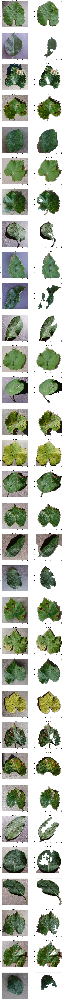

In [253]:
print_test(37, 1000, 1)